<a href="https://www.kaggle.com/code/anchitmehra/open-cv-basics?scriptVersionId=217061131" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# OPEN CV

# Reading images


In [1]:
!pip install opencv-contrib-python


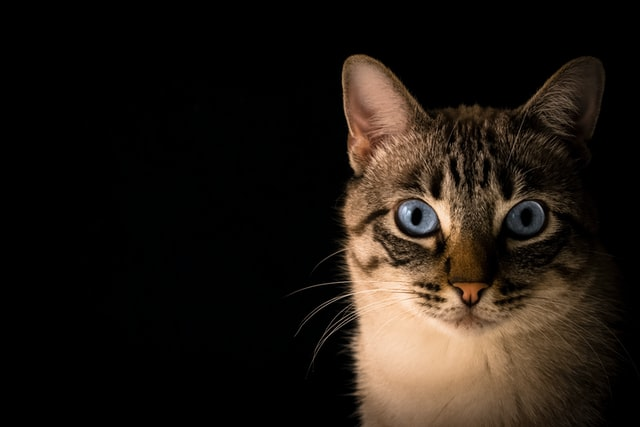

-1

In [2]:
from google.colab.patches import cv2_imshow
import cv2 as cv

# Read the image
img = cv.imread('/kaggle/input/resources/cat.jpg')

# Display the image using cv2_imshow
cv2_imshow(img)

# Wait for a key press (not necessary in Colab, but keeping it for consistency)
cv.waitKey(0)


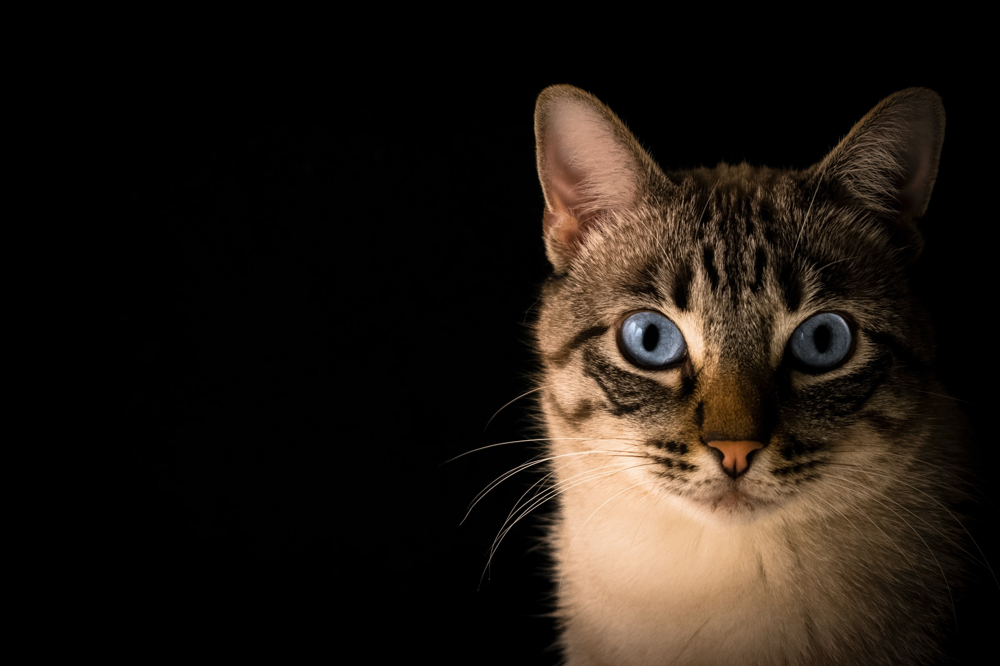

-1

In [3]:

# Read the image
img = cv.imread('/kaggle/input/resources/cat_large.jpg')

# Display the image using cv2_imshow
cv2_imshow(img)

# Wait for a key press (not necessary in Colab, but keeping it for consistency)
cv.waitKey(0)


# Reading Video

In [4]:

capture = cv.VideoCapture('/content/dog.mp4')

while True:
    isTrue, frame = capture.read()

    # if cv.waitKey(20) & 0xFF==ord('d'):
    # This is the preferred way - if `isTrue` is false (the frame could
    # not be read, or we're at the end of the video), we immediately
    # break from the loop.
    if isTrue:
        cv2_imshow(frame)
        if cv.waitKey(20) & 0xFF==ord('d'):
            break
    else:
        break

capture.release()
cv.destroyAllWindows()

In [5]:
from IPython.display import Video

# Display the video
Video('/kaggle/input/resources/dog.mp4', embed=True)


In [6]:
from IPython.display import HTML
from base64 import b64decode

HTML("""
<video id="video" width=400 height=300 autoplay muted></video>
<button id="start">Start Recording</button>
<button id="stop">Stop Recording</button>
<br/>
<video id="playback" width=400 height=300 controls></video>
<script>
  const video = document.getElementById('video');
  const start = document.getElementById('start');
  const stop = document.getElementById('stop');
  const playback = document.getElementById('playback');
  let mediaRecorder;
  let recordedChunks = [];

  navigator.mediaDevices.getUserMedia({ video: true }).then((stream) => {
    video.srcObject = stream;
    mediaRecorder = new MediaRecorder(stream);

    mediaRecorder.ondataavailable = (e) => recordedChunks.push(e.data);
    mediaRecorder.onstop = () => {
      const blob = new Blob(recordedChunks, { type: 'video/webm' });
      playback.src = URL.createObjectURL(blob);
      const reader = new FileReader();
      reader.readAsDataURL(blob);
      reader.onloadend = () => {
        const base64data = reader.result.split(',')[1];
        google.colab.kernel.invokeFunction('notebook.save_video', [base64data], {});
      };
    };
  });

  start.onclick = () => {
    recordedChunks = [];
    mediaRecorder.start();
  };

  stop.onclick = () => mediaRecorder.stop();
</script>
""")


In [7]:
def save_video(data):
    with open("recorded_video.webm", "wb") as f:
        f.write(b64decode(data))

from google.colab import output
output.register_callback('notebook.save_video', save_video)


# Resizing and rescaling frames

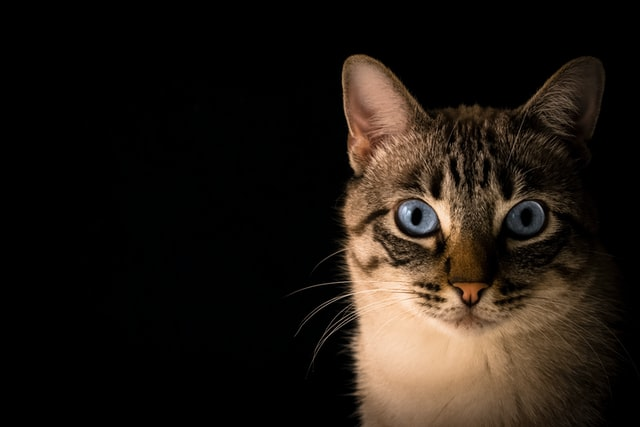

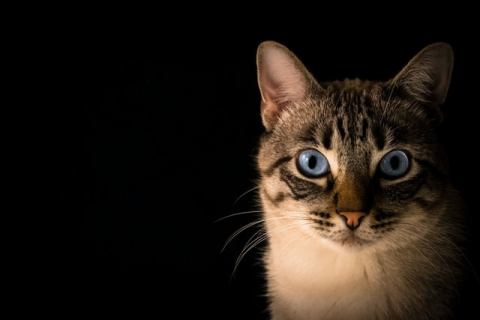

-1

In [8]:
img = cv.imread('/kaggle/input/resources/cat.jpg')
cv2_imshow(img)
def rescaleFrame(frame, scale=0.75):
    width = int(frame.shape[1] * scale)
    height = int(frame.shape[0] * scale)
    dimensions = (width, height)

    return cv.resize(frame, dimensions, interpolation=cv.INTER_AREA)

resized_image = rescaleFrame(img)
cv2_imshow(resized_image)

cv.waitKey(0)

# Drawing shapes and putting text

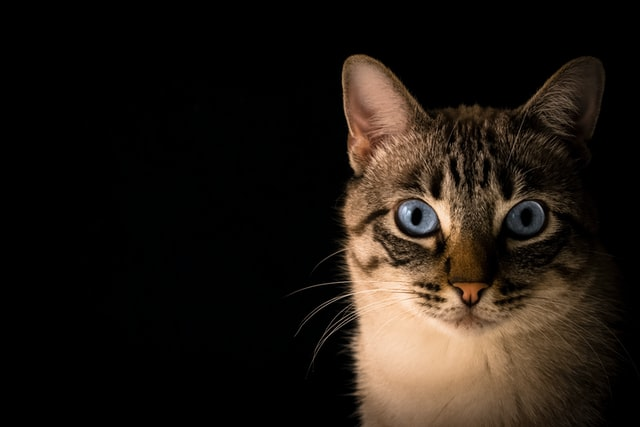

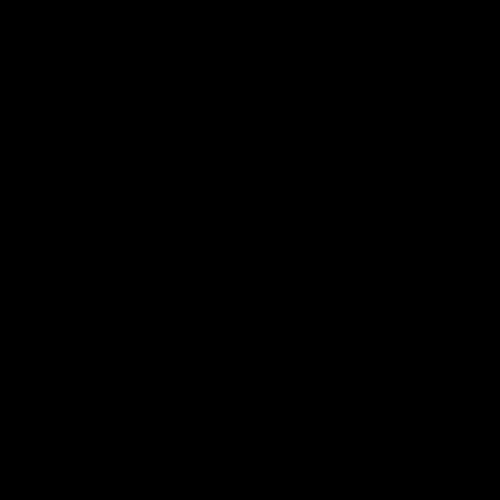

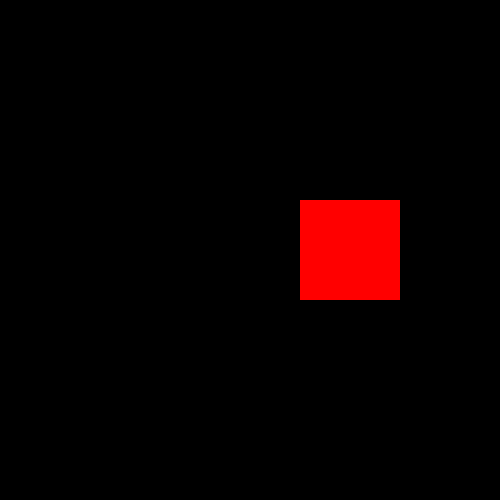

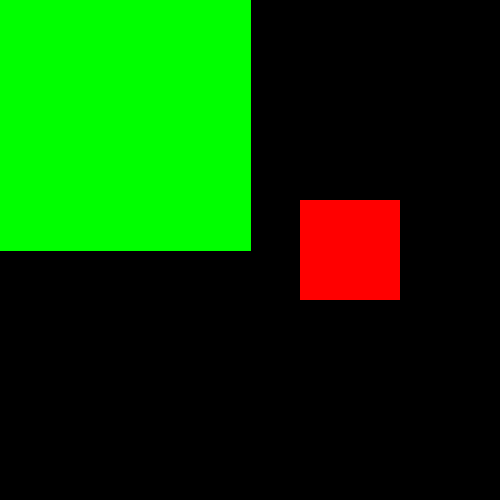

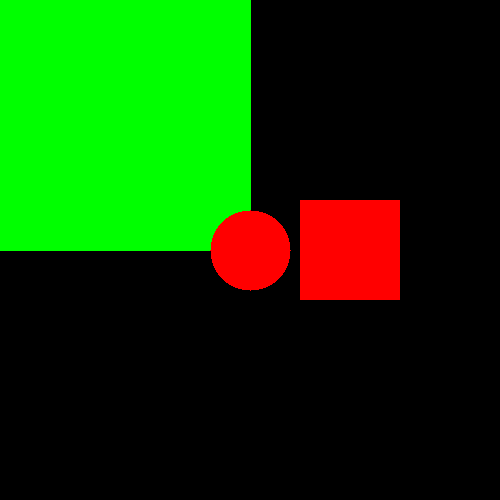

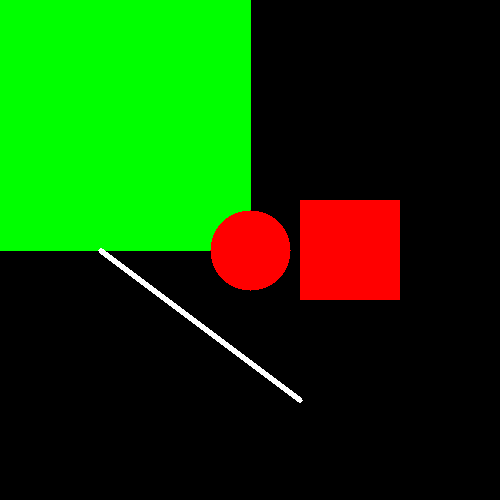

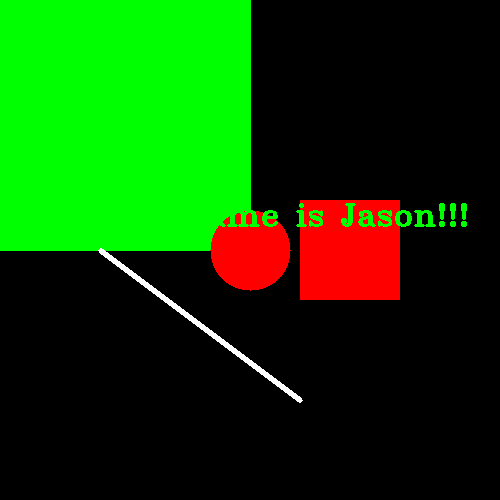

-1

In [9]:
import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/cat.jpg')
cv2_imshow(img)

blank = np.zeros((500,500,3), dtype='uint8')
cv2_imshow(blank)

# 1. Paint the image a certain colour
blank[200:300, 300:400] = 0,0,255
cv2_imshow(blank)

# 2. Draw a Rectangle
cv.rectangle(blank, (0,0), (blank.shape[1]//2, blank.shape[0]//2), (0,255,0), thickness=-1)
cv2_imshow(blank)

# 3. Draw A circle
cv.circle(blank, (blank.shape[1]//2, blank.shape[0]//2), 40, (0,0,255), thickness=-1)
cv2_imshow(blank)

# 4. Draw a line
cv.line(blank, (100,250), (300,400), (255,255,255), thickness=3)
cv2_imshow(blank)

# 5. Write text
cv.putText(blank, 'Hello, my name is Jason!!!', (0,225), cv.FONT_HERSHEY_TRIPLEX, 1.0, (0,255,0), 2)
cv2_imshow(blank)

cv.waitKey(0)

# 5 essential functions in open cv

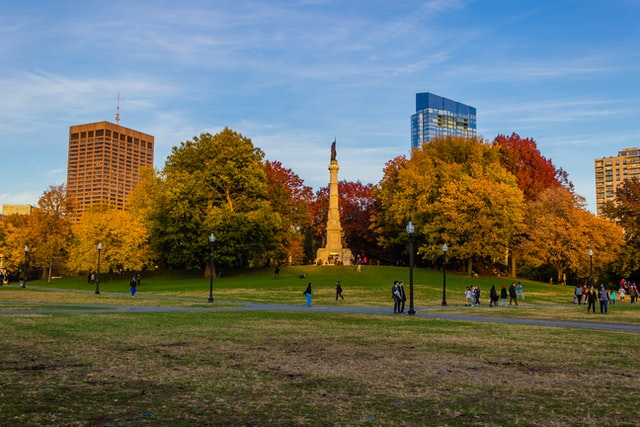

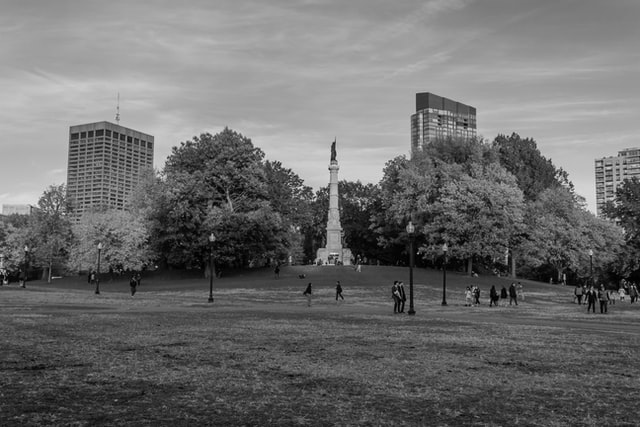

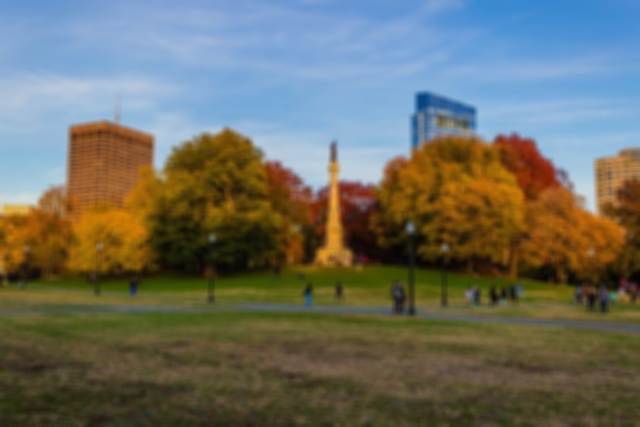

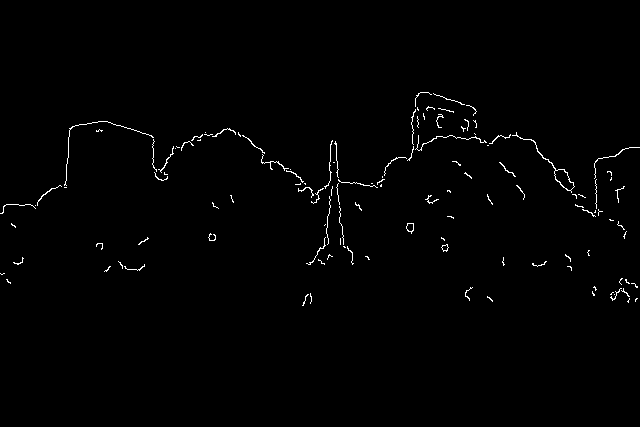

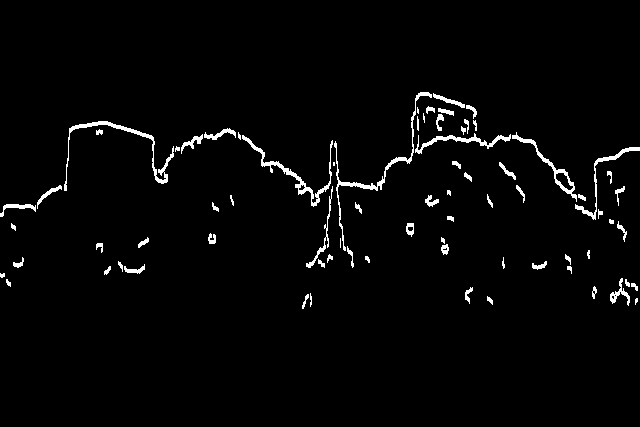

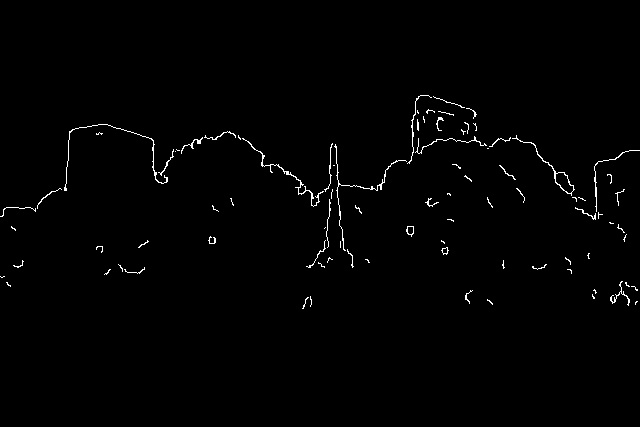

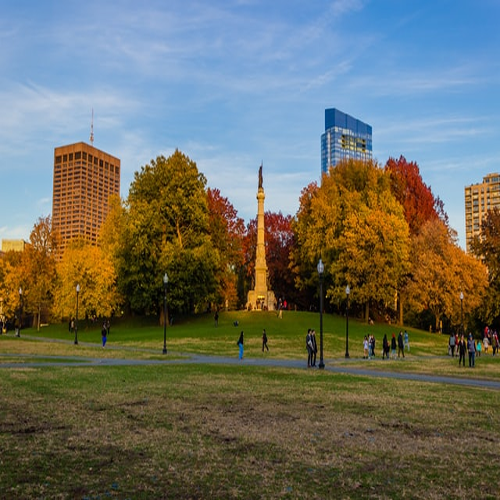

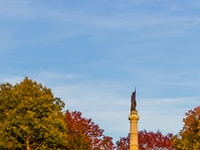

In [10]:
#pylint:disable=no-member

import cv2 as cv

# Read in an image
img = cv.imread('/kaggle/input/resources/park.jpg')
cv2_imshow(img)

# Converting to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

# Blur
blur = cv.GaussianBlur(img, (7,7), cv.BORDER_DEFAULT)
cv2_imshow(blur)

# Edge Cascade
canny = cv.Canny(blur, 125, 175)
cv2_imshow(canny)

# Dilating the image
dilated = cv.dilate(canny, (7,7), iterations=3)
cv2_imshow(dilated)

# Eroding
eroded = cv.erode(dilated, (7,7), iterations=3)
cv2_imshow(eroded)

# Resize
resized = cv.resize(img, (500,500), interpolation=cv.INTER_CUBIC)
cv2_imshow(resized)

# Cropping
cropped = img[50:200, 200:400]
cv2_imshow(cropped)

# Image Transformation

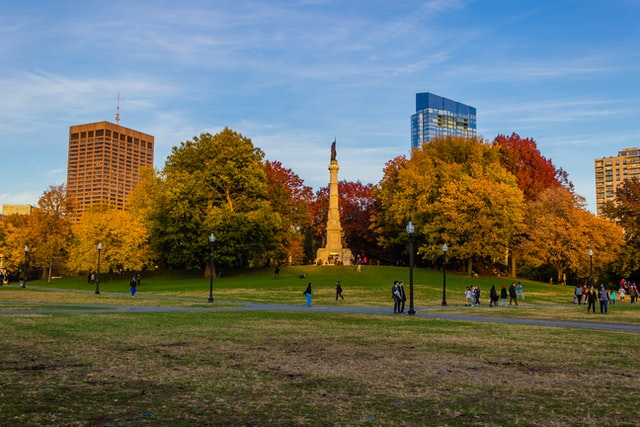

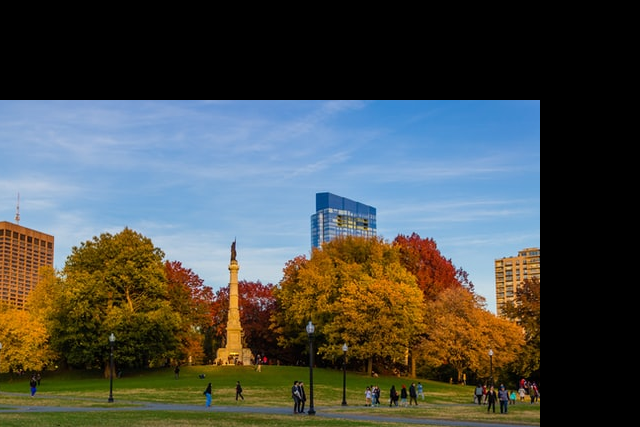

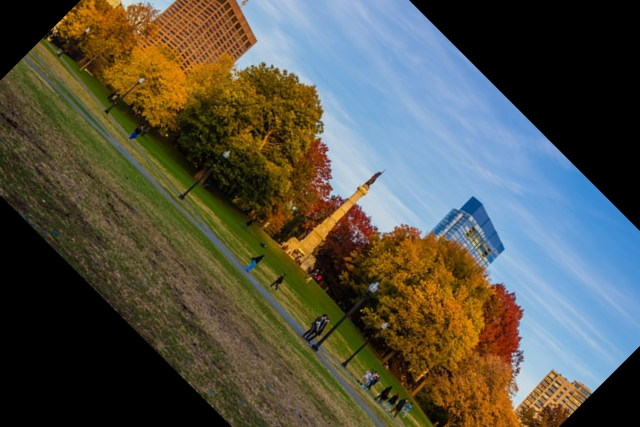

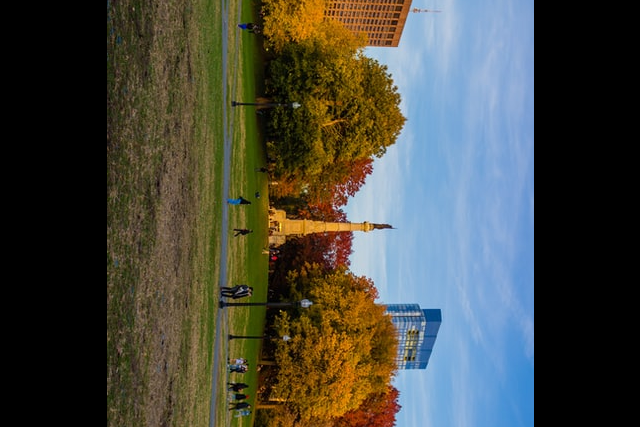

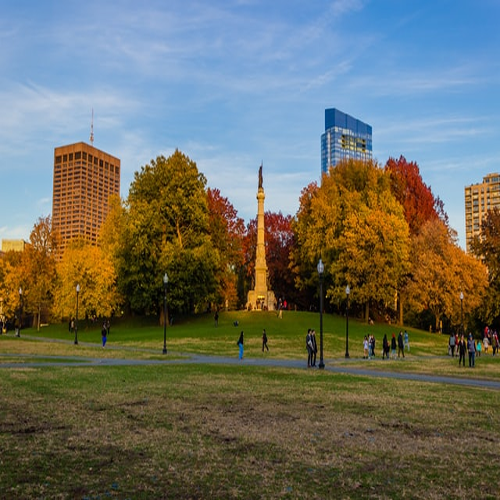

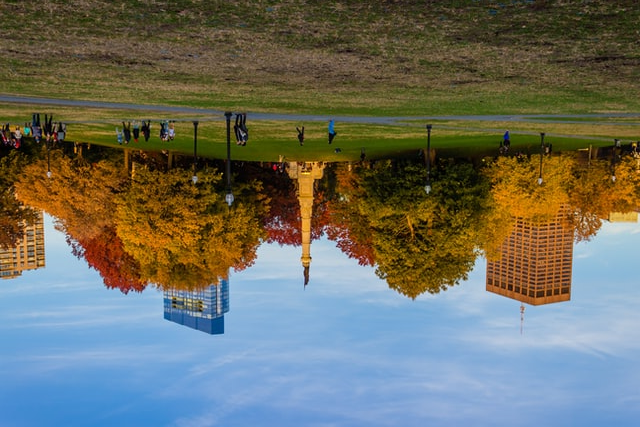

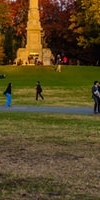

-1

In [11]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/park.jpg')
cv2_imshow(img)

# Translation
def translate(img, x, y):
    transMat = np.float32([[1,0,x],[0,1,y]])
    dimensions = (img.shape[1], img.shape[0])
    return cv.warpAffine(img, transMat, dimensions)

# -x --> Left
# -y --> Up
# x --> Right
# y --> Down

translated = translate(img, -100, 100)
cv2_imshow(translated)

# Rotation
def rotate(img, angle, rotPoint=None):
    (height,width) = img.shape[:2]

    if rotPoint is None:
        rotPoint = (width//2,height//2)

    rotMat = cv.getRotationMatrix2D(rotPoint, angle, 1.0)
    dimensions = (width,height)

    return cv.warpAffine(img, rotMat, dimensions)

rotated = rotate(img, -45)
cv2_imshow(rotated)

rotated_rotated = rotate(img, -90)
cv2_imshow(rotated_rotated)

# Resizing
resized = cv.resize(img, (500,500), interpolation=cv.INTER_CUBIC)
cv2_imshow(resized)

# Flipping
flip = cv.flip(img, -1)
cv2_imshow(flip)

# Cropping
cropped = img[200:400, 300:400]
cv2_imshow(cropped)


cv.waitKey(0)

# Contour Detection

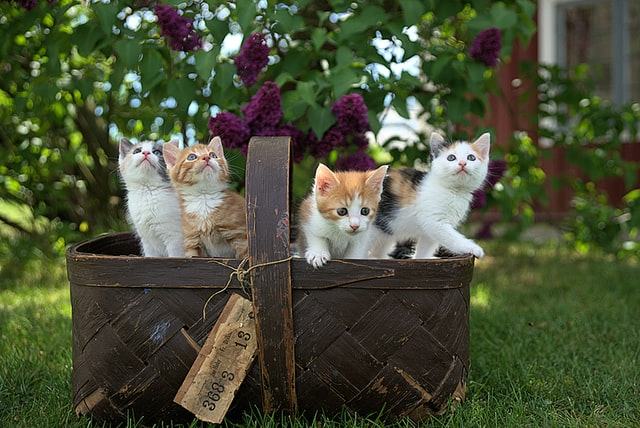

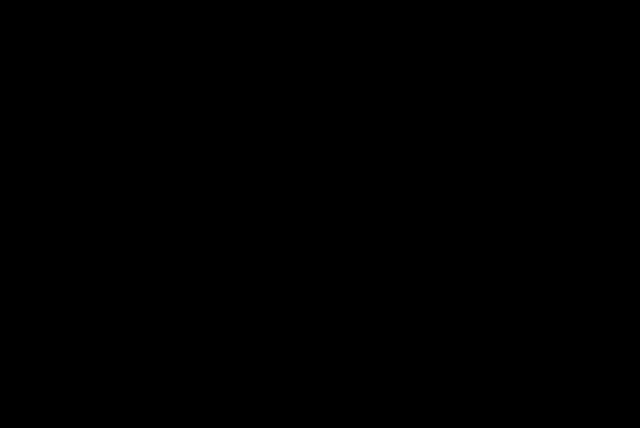

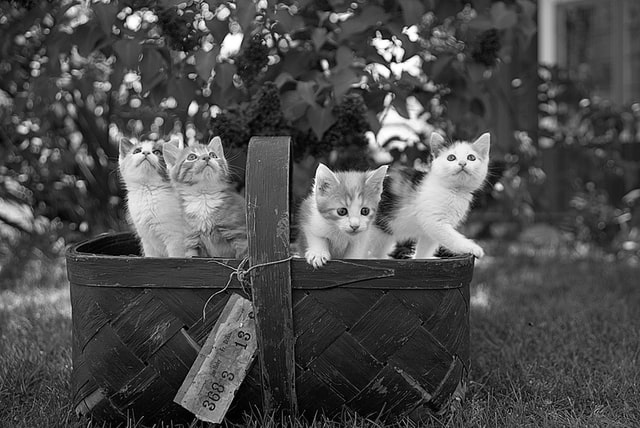

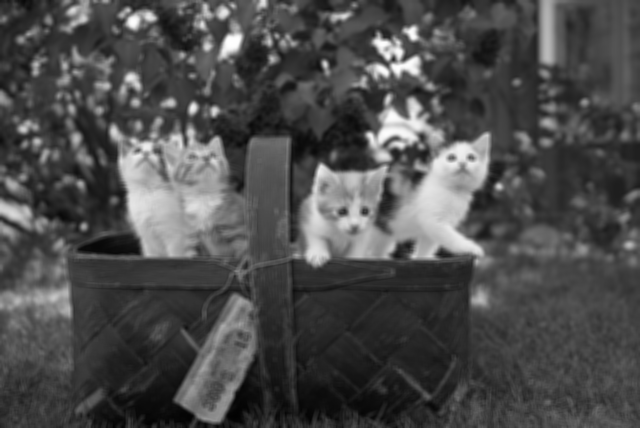

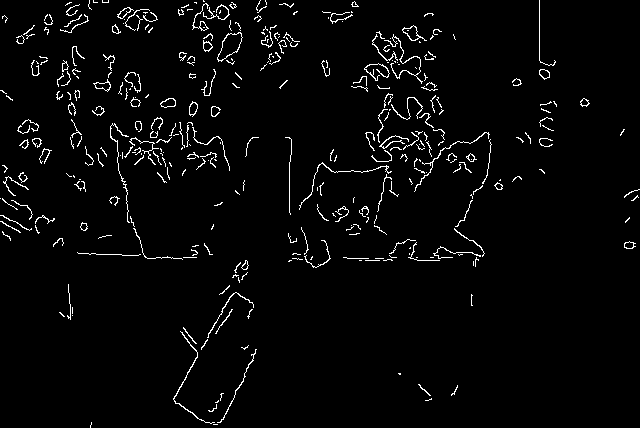

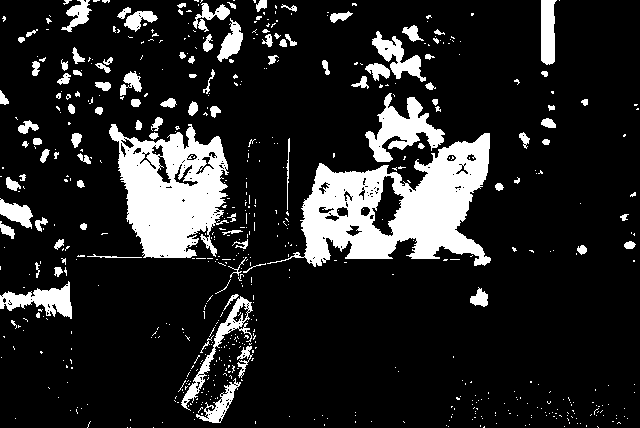

839 contour(s) found!


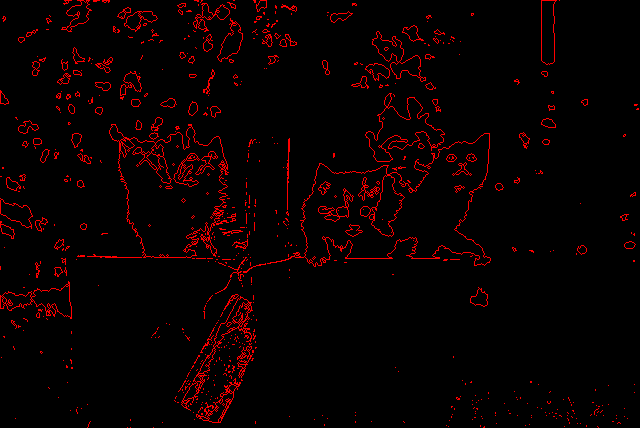

-1

In [12]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/cats.jpg')
cv2_imshow(img)

blank = np.zeros(img.shape, dtype='uint8')
cv2_imshow(blank)

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

blur = cv.GaussianBlur(gray, (5,5), cv.BORDER_DEFAULT)
cv2_imshow(blur)

canny = cv.Canny(blur, 125, 175)
cv2_imshow(canny)

ret, thresh = cv.threshold(gray, 125, 255, cv.THRESH_BINARY)
cv2_imshow(thresh)

contours, hierarchies = cv.findContours(thresh, cv.RETR_LIST, cv.CHAIN_APPROX_SIMPLE)
print(f'{len(contours)} contour(s) found!')

cv.drawContours(blank, contours, -1, (0,0,255), 1)
cv2_imshow(blank)

cv.waitKey(0)

# Colur Spaces

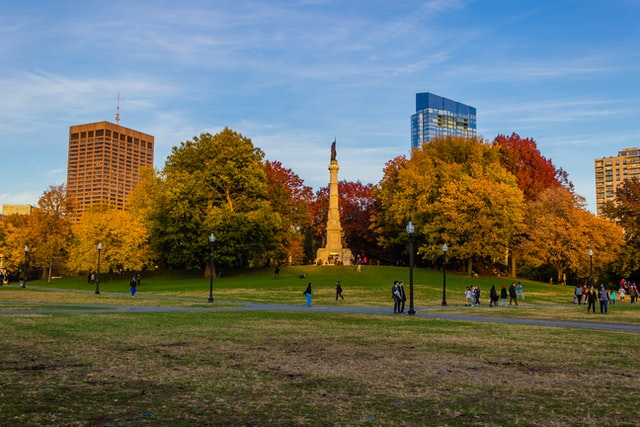

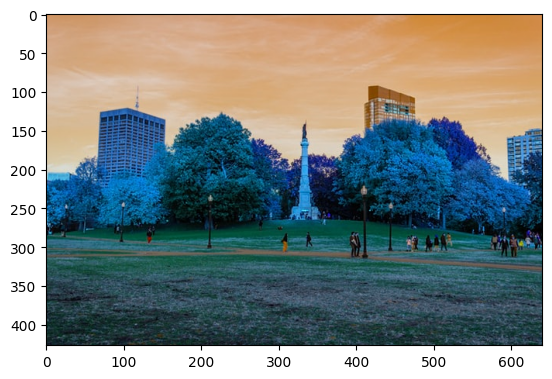

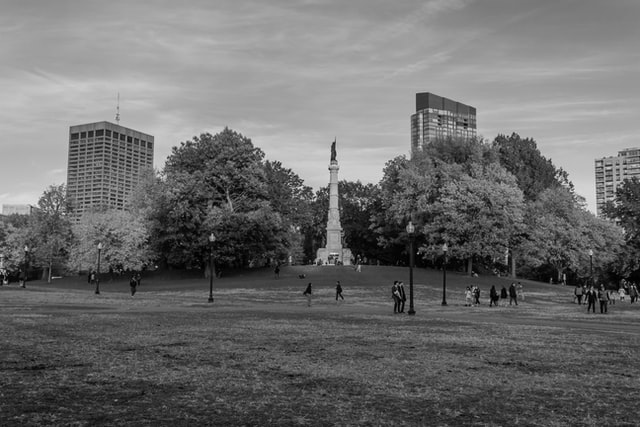

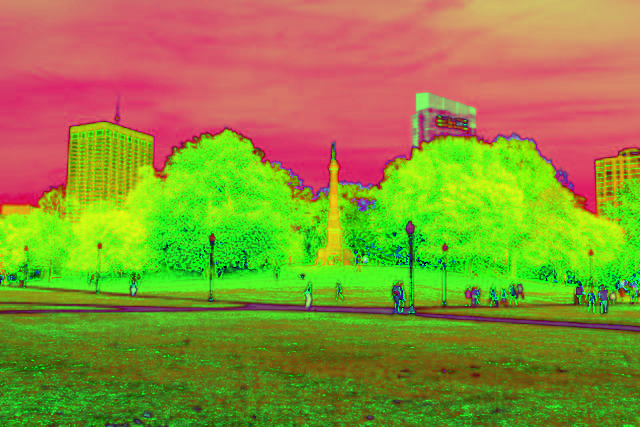

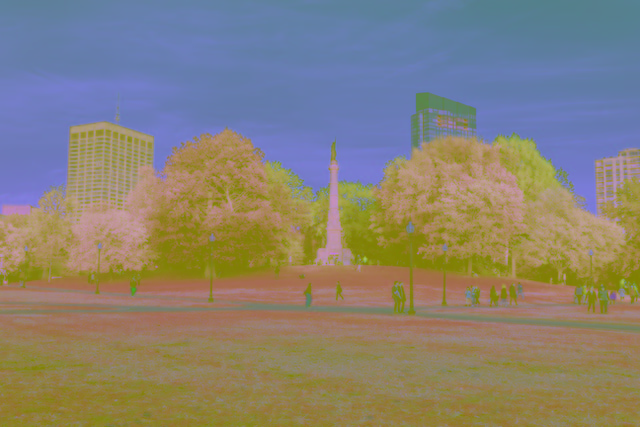

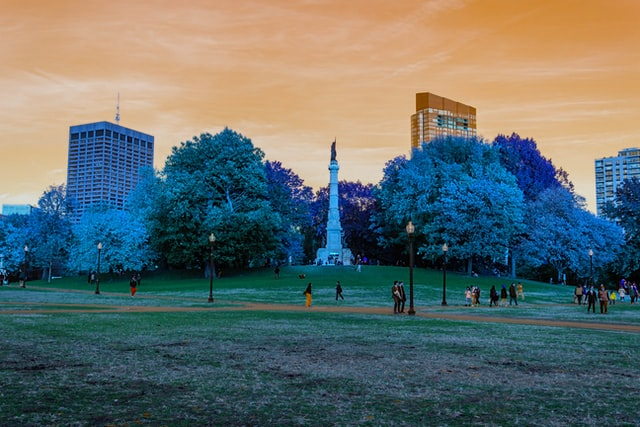

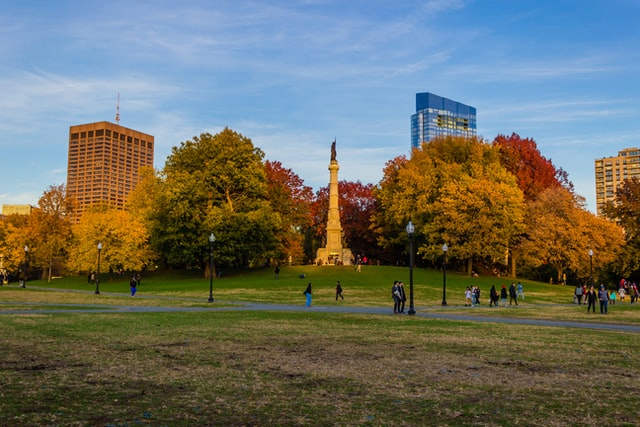

-1

In [13]:
#pylint:disable=no-member

import cv2 as cv
import matplotlib.pyplot as plt

img = cv.imread('/kaggle/input/resources/park.jpg')
cv2_imshow(img)

plt.imshow(img)
plt.show()

# BGR to Grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

# BGR to HSV
hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
cv2_imshow(hsv)

# BGR to L*a*b
lab = cv.cvtColor(img, cv.COLOR_BGR2LAB)
cv2_imshow(lab)

# BGR to RGB
rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
cv2_imshow(rgb)

# HSV to BGR
lab_bgr = cv.cvtColor(lab, cv.COLOR_LAB2BGR)
cv2_imshow(lab_bgr)

cv.waitKey(0)

# Colour Channels

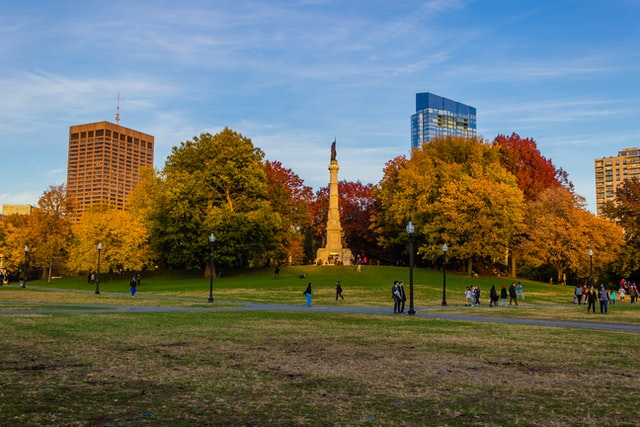

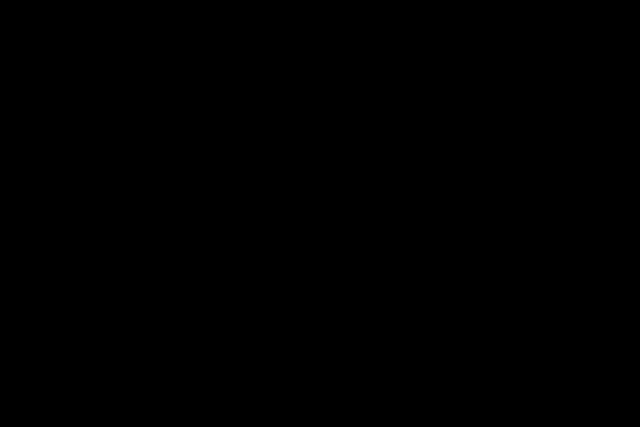

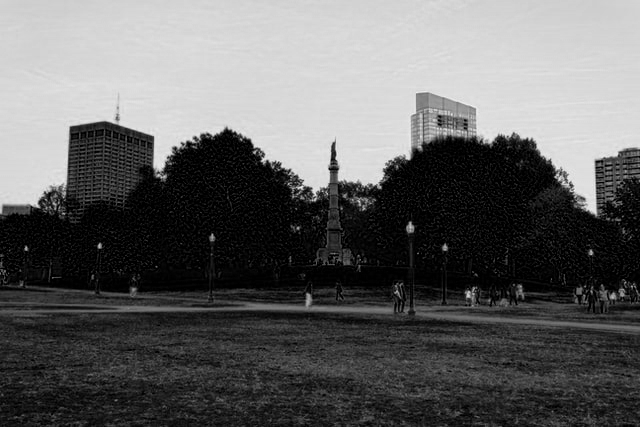

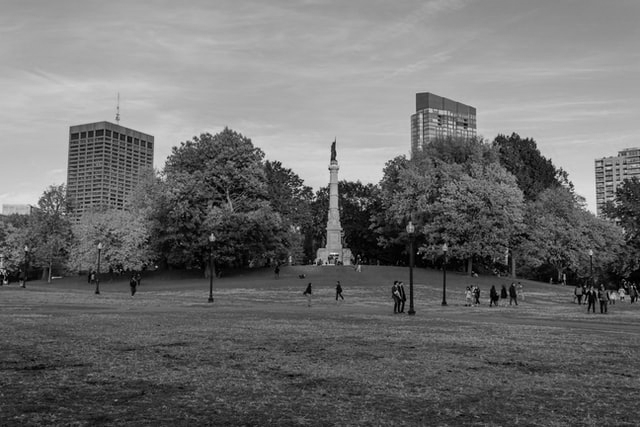

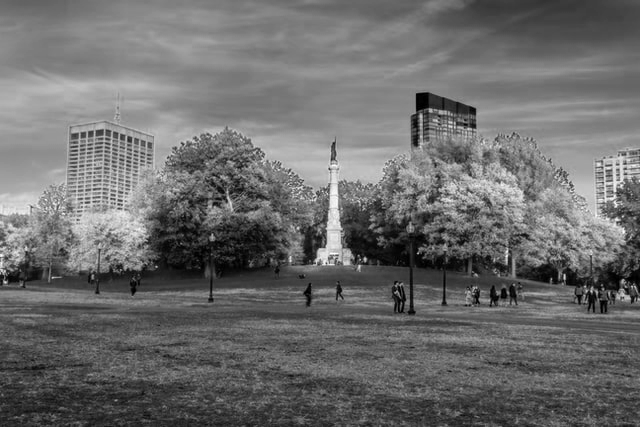

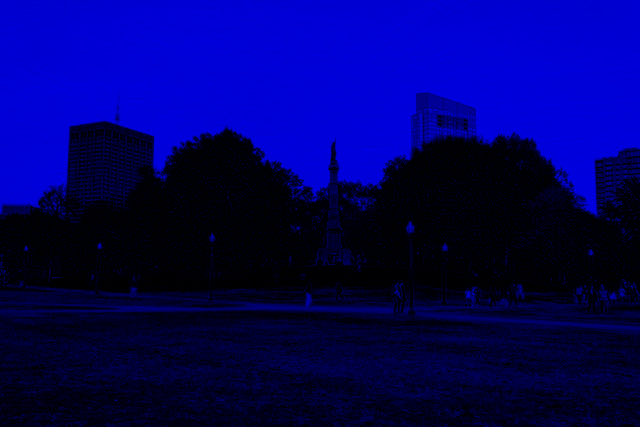

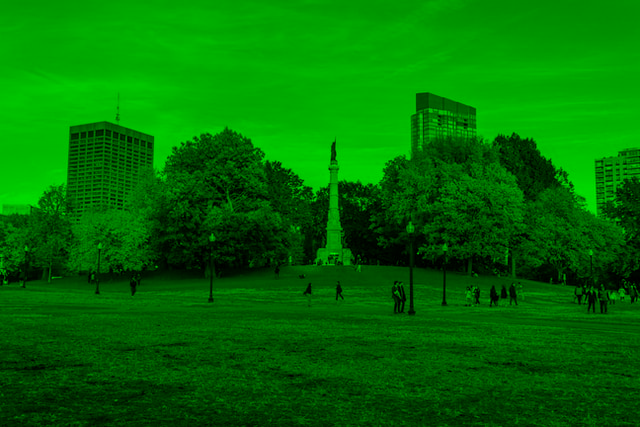

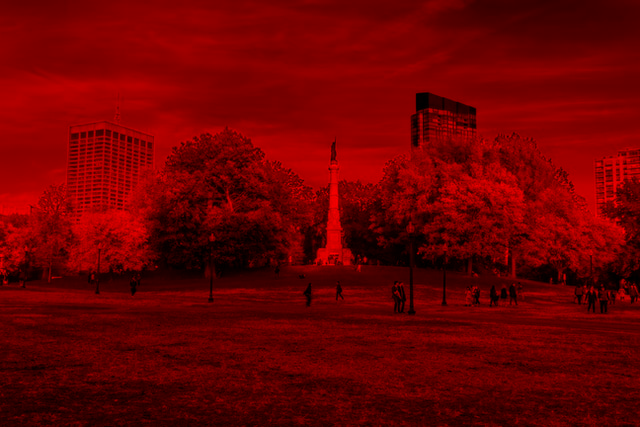

(427, 640, 3)
(427, 640)
(427, 640)
(427, 640)


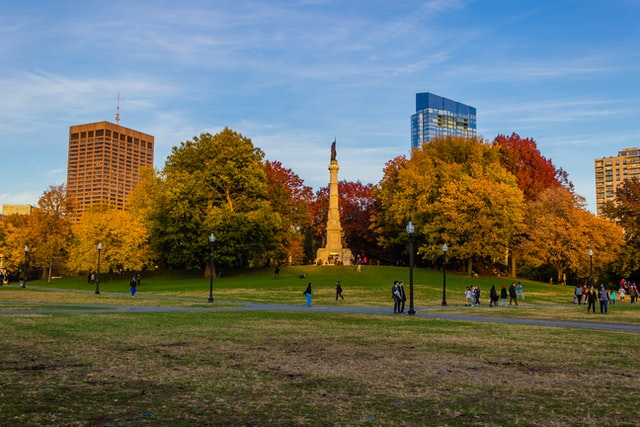

-1

In [14]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/park.jpg')
cv2_imshow(img)

blank = np.zeros(img.shape[:2], dtype='uint8')
cv2_imshow(blank)

b,g,r = cv.split(img)
cv2_imshow(b)
cv2_imshow(g)
cv2_imshow(r)


blue = cv.merge([b,blank,blank])
green = cv.merge([blank,g,blank])
red = cv.merge([blank,blank,r])


cv2_imshow(blue)
cv2_imshow(green)
cv2_imshow(red)

print(img.shape)
print(b.shape)
print(g.shape)
print(r.shape)

merged = cv.merge([b,g,r])
cv2_imshow(merged)

cv.waitKey(0)

# Blurring

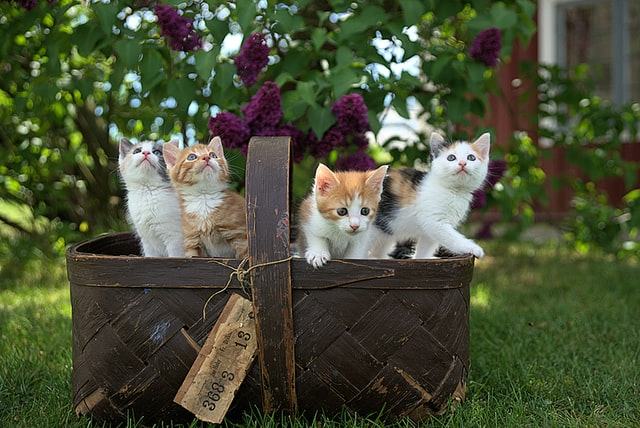

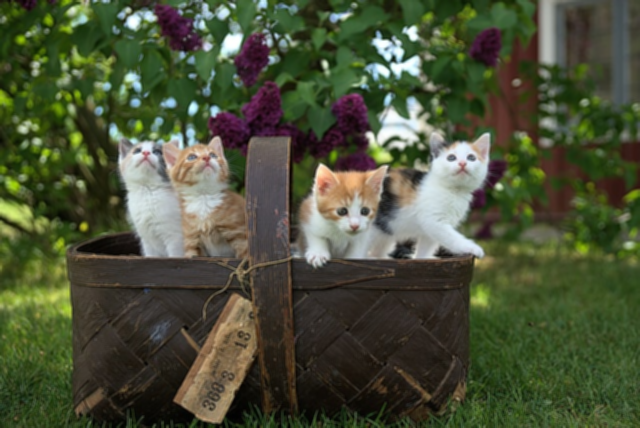

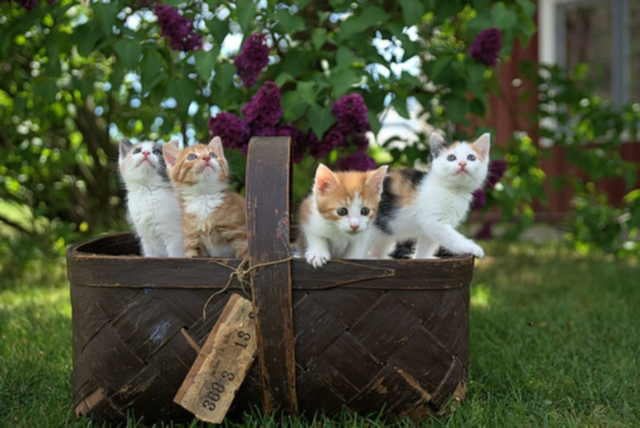

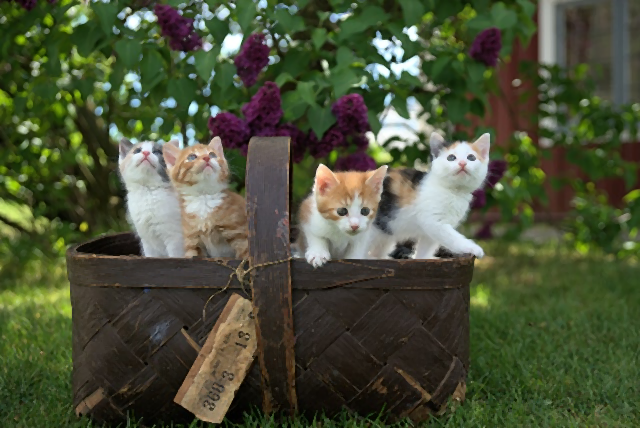

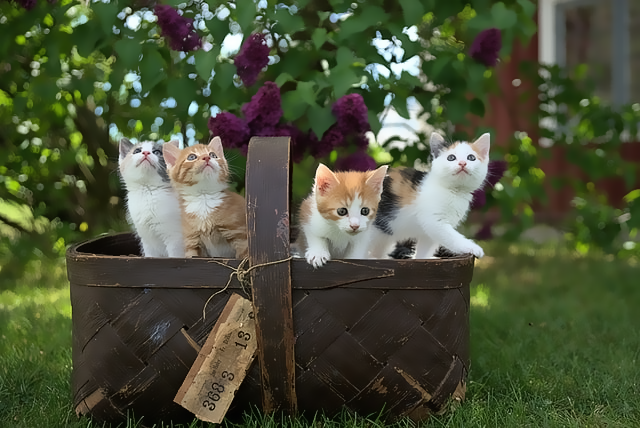

-1

In [15]:
#pylint:disable=no-member

import cv2 as cv

img = cv.imread('/kaggle/input/resources/cats.jpg')
cv2_imshow(img)

# Averaging
average = cv.blur(img, (3,3))
cv2_imshow(average)

# Gaussian Blur
gauss = cv.GaussianBlur(img, (3,3), 0)
cv2_imshow(gauss)

# Median Blur
median = cv.medianBlur(img, 3)
cv2_imshow(median)

# Bilateral
bilateral = cv.bilateralFilter(img, 10, 35, 25)
cv2_imshow(bilateral)

cv.waitKey(0)

# Bitwise

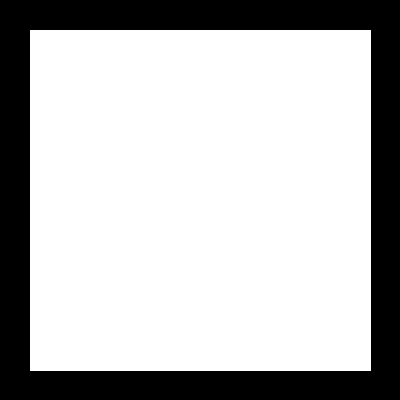

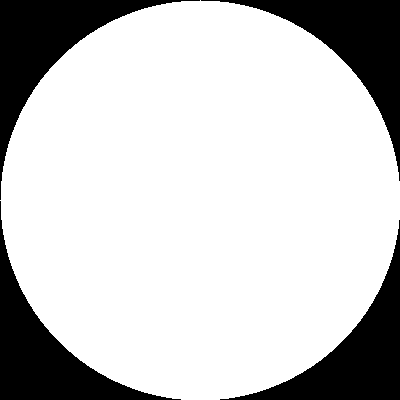

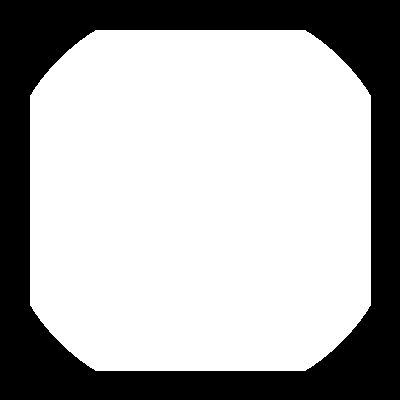

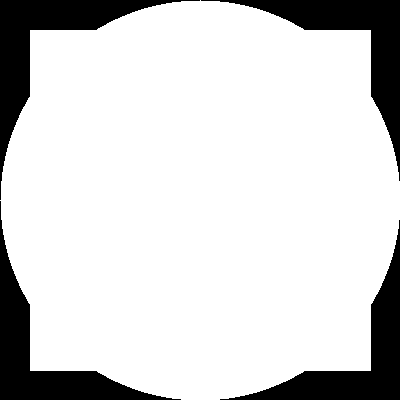

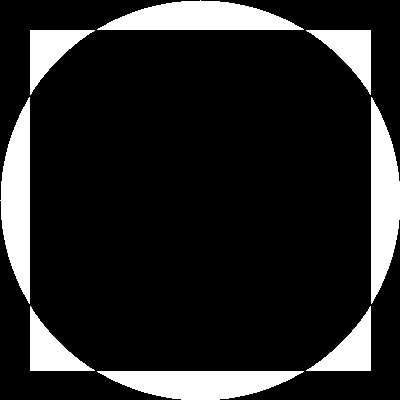

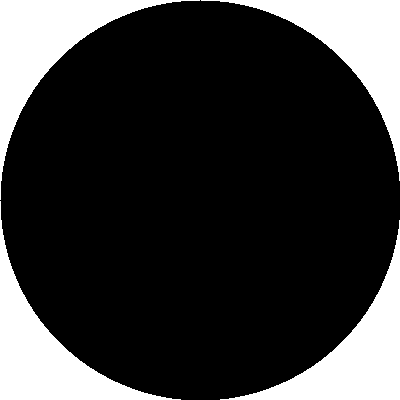

-1

In [16]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

blank = np.zeros((400,400), dtype='uint8')

rectangle = cv.rectangle(blank.copy(), (30,30), (370,370), 255, -1)
circle = cv.circle(blank.copy(), (200,200), 200, 255, -1)

cv2_imshow(rectangle)
cv2_imshow(circle)

# bitwise AND --> intersecting regions
bitwise_and = cv.bitwise_and(rectangle, circle)
cv2_imshow(bitwise_and)

# bitwise OR --> non-intersecting and intersecting regions
bitwise_or = cv.bitwise_or(rectangle, circle)
cv2_imshow(bitwise_or)

# bitwise XOR --> non-intersecting regions
bitwise_xor = cv.bitwise_xor(rectangle, circle)
cv2_imshow(bitwise_xor)

# bitwise NOT
bitwise_not = cv.bitwise_not(circle)
cv2_imshow( bitwise_not)

cv.waitKey(0)

# Masking

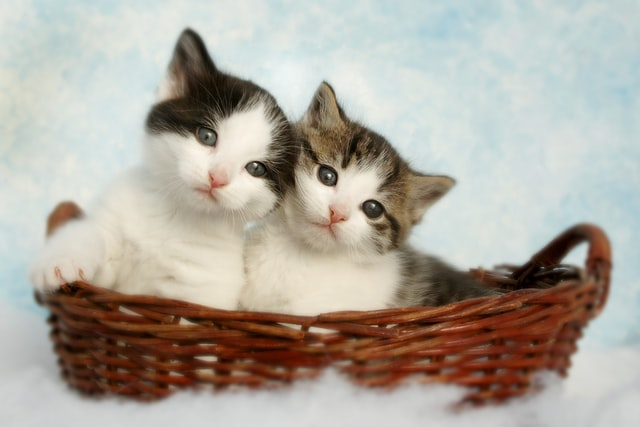

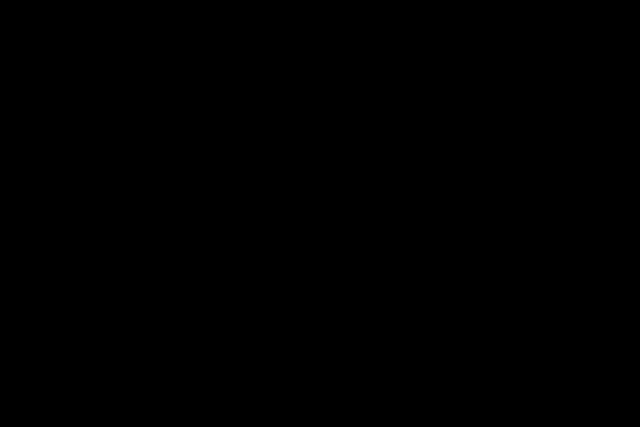

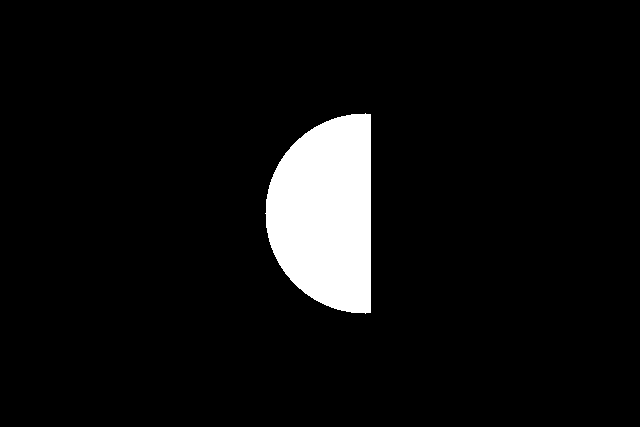

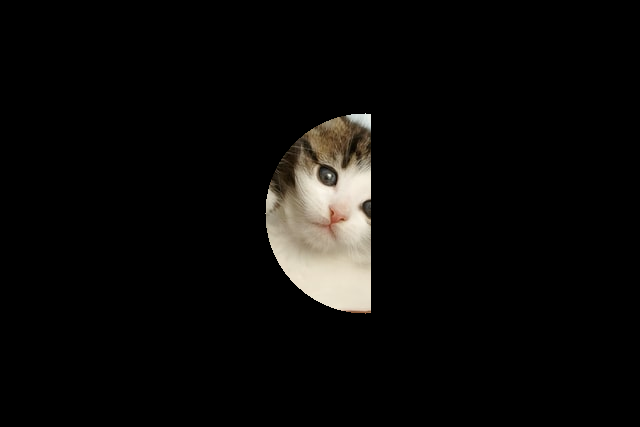

-1

In [17]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/cats 2.jpg')
cv2_imshow(img)

blank = np.zeros(img.shape[:2], dtype='uint8')
cv2_imshow(blank)

circle = cv.circle(blank.copy(), (img.shape[1]//2 + 45,img.shape[0]//2), 100, 255, -1)

rectangle = cv.rectangle(blank.copy(), (30,30), (370,370), 255, -1)

weird_shape = cv.bitwise_and(circle,rectangle)
cv2_imshow(weird_shape)

masked = cv.bitwise_and(img,img,mask=weird_shape)
cv2_imshow( masked)

cv.waitKey(0)

# Histogram

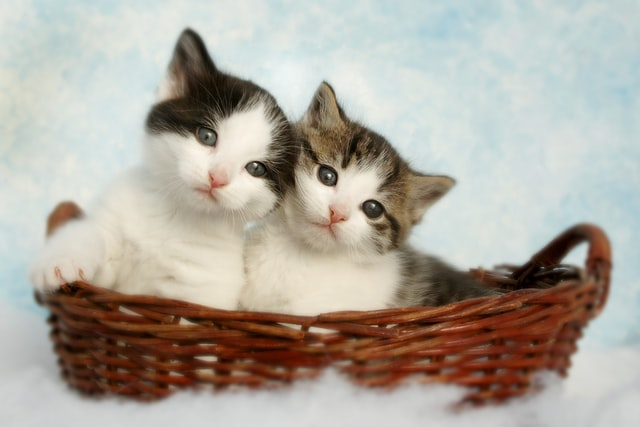

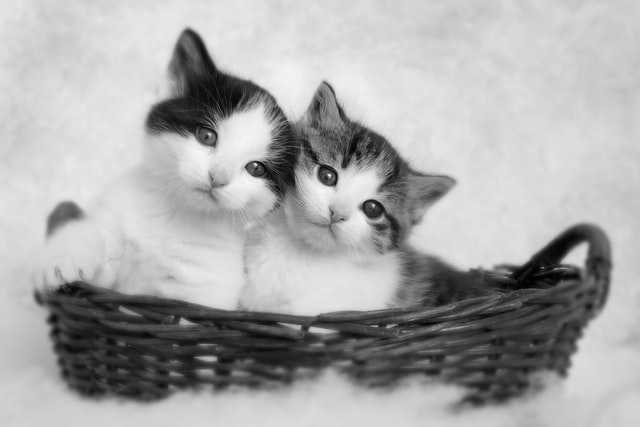

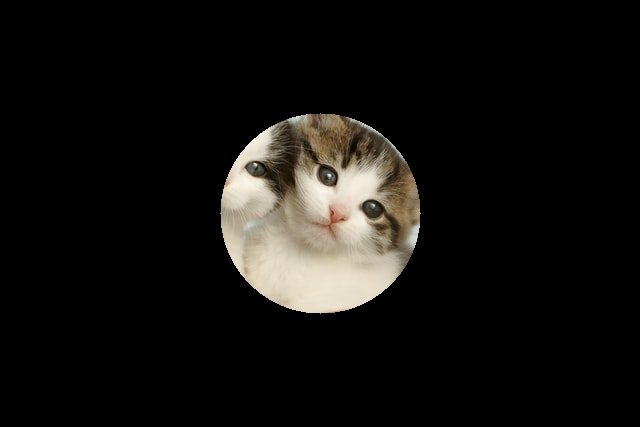

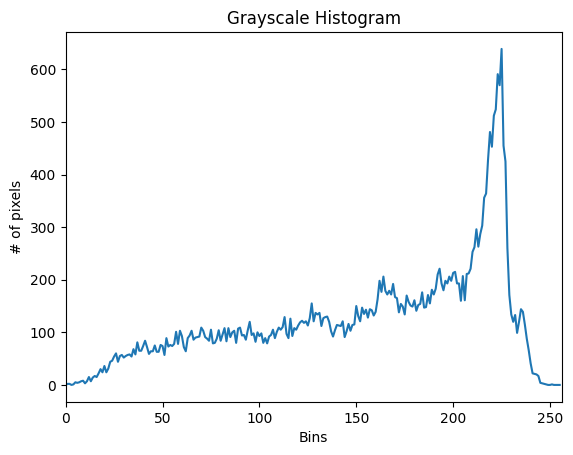

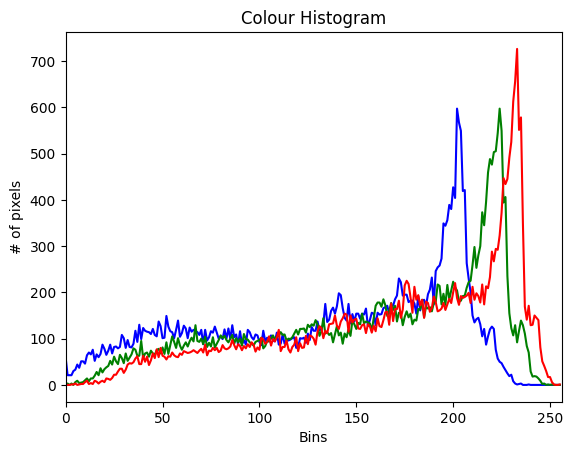

-1

In [18]:
#pylint:disable=no-member

import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np

img = cv.imread('/kaggle/input/resources/cats 2.jpg')
cv2_imshow(img)

blank = np.zeros(img.shape[:2], dtype='uint8')

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

mask = cv.circle(blank, (img.shape[1]//2,img.shape[0]//2), 100, 255, -1)

masked = cv.bitwise_and(img,img,mask=mask)
cv2_imshow(masked)

# GRayscale histogram
gray_hist = cv.calcHist([gray], [0], mask, [256], [0,256] )

plt.figure()
plt.title('Grayscale Histogram')
plt.xlabel('Bins')
plt.ylabel('# of pixels')
plt.plot(gray_hist)
plt.xlim([0,256])
plt.show()

# Colour Histogram

plt.figure()
plt.title('Colour Histogram')
plt.xlabel('Bins')
plt.ylabel('# of pixels')
colors = ('b', 'g', 'r')
for i,col in enumerate(colors):
    hist = cv.calcHist([img], [i], mask, [256], [0,256])
    plt.plot(hist, color=col)
    plt.xlim([0,256])

plt.show()

cv.waitKey(0)

# Thresholding/binaring

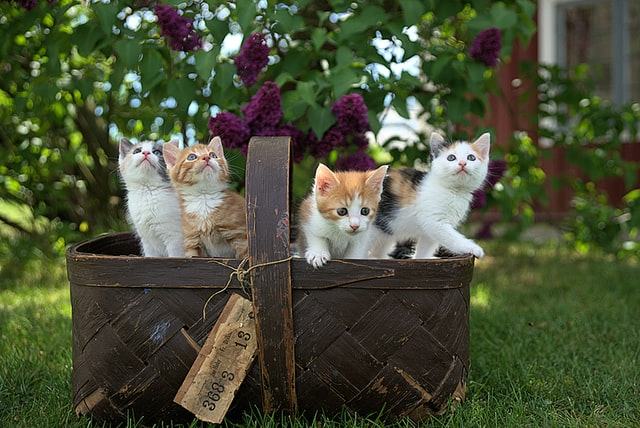

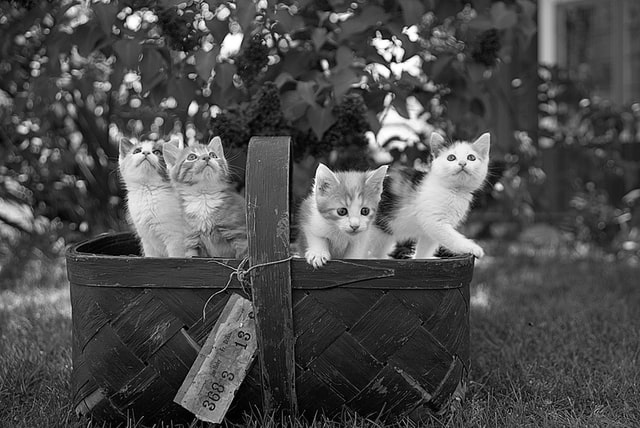

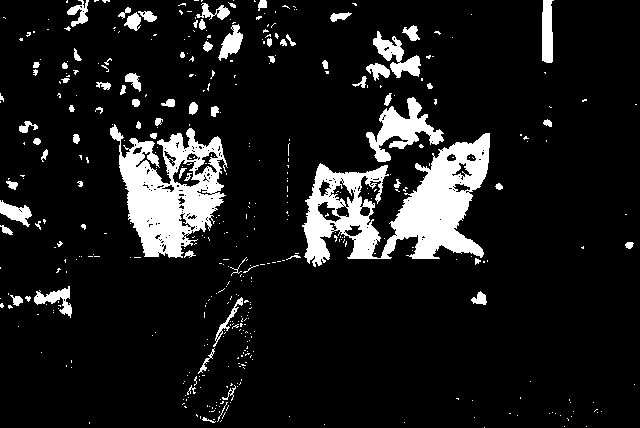

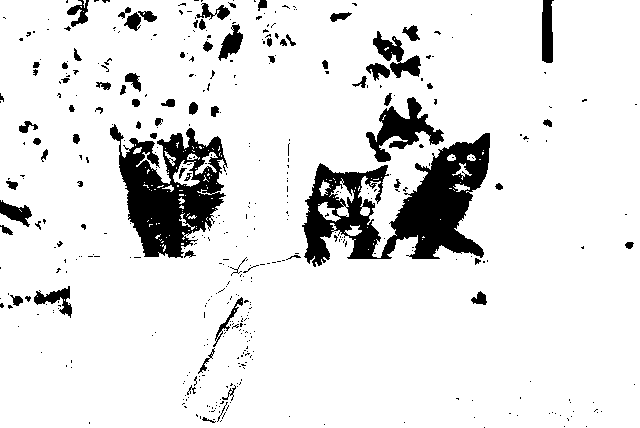

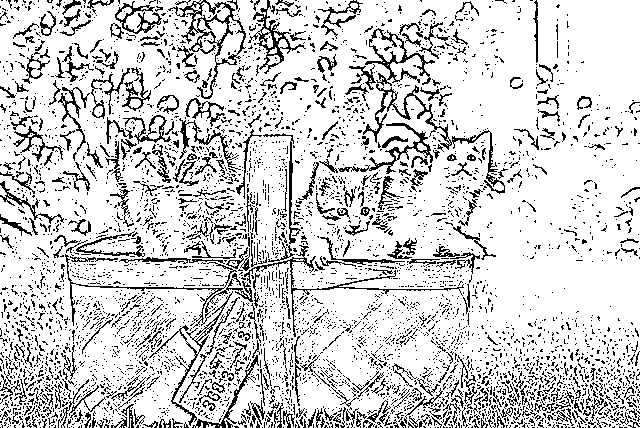

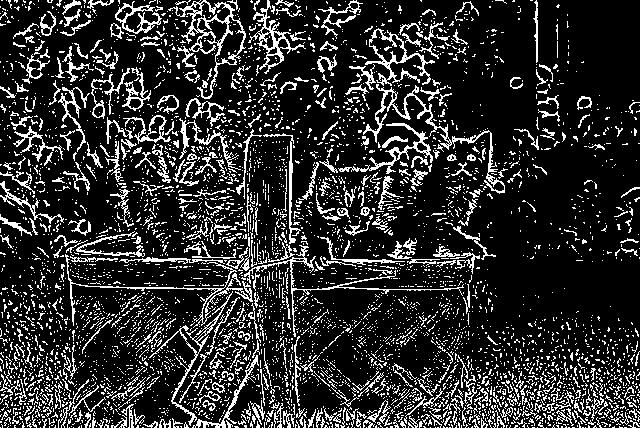

-1

In [19]:
#pylint:disable=no-member

import cv2 as cv

img = cv.imread('/kaggle/input/resources/cats.jpg')
cv2_imshow(img)

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

# Simple Thresholding
threshold, thresh = cv.threshold(gray, 150, 255, cv.THRESH_BINARY )
cv2_imshow(thresh)

threshold, thresh_inv = cv.threshold(gray, 150, 255, cv.THRESH_BINARY_INV )
cv2_imshow(thresh_inv)

# Adaptive Thresholding

adaptive_thresha = cv.adaptiveThreshold(gray, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 11, 9)
cv2_imshow(adaptive_thresha)

adaptive_thresh = cv.adaptiveThreshold(gray, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY_INV, 11, 9)
cv2_imshow(adaptive_thresh)

cv.waitKey(0)

# Edge Dection

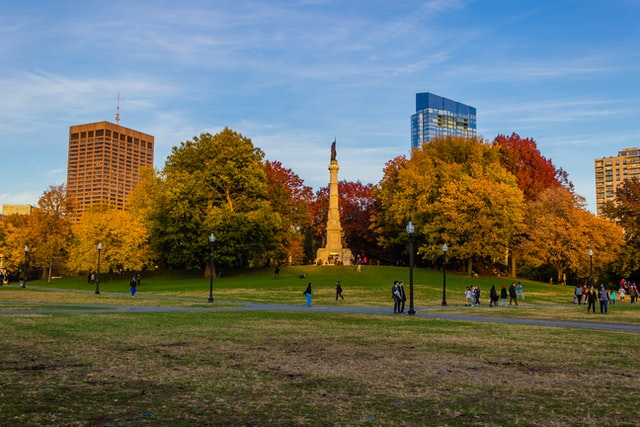

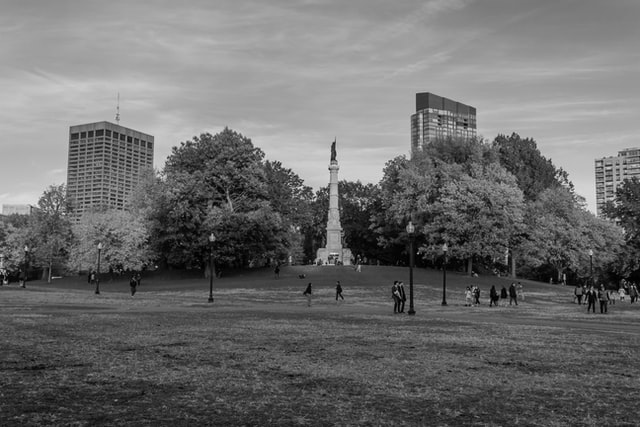

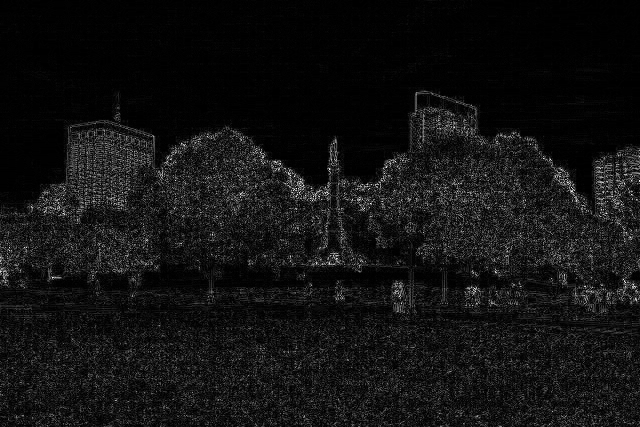

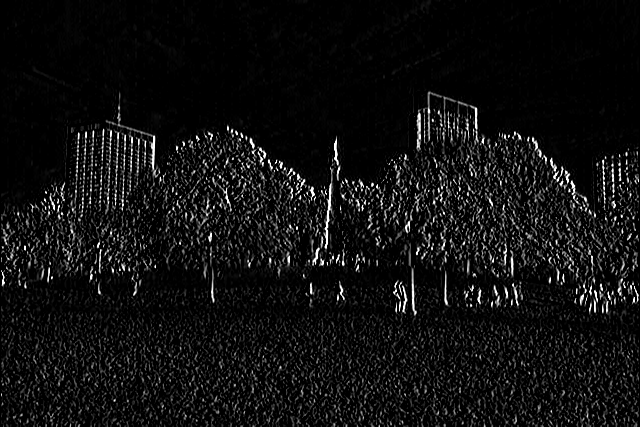

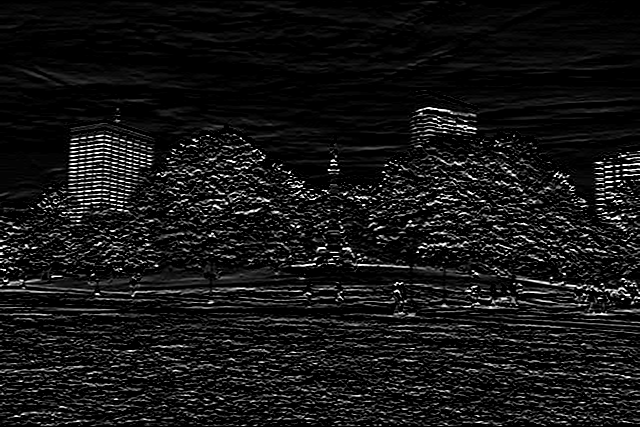

/usr/local/lib/python3.10/dist-packages/google/colab/patches/__init__.py:18: RuntimeWarning: invalid value encountered in cast
  a = a.clip(0, 255).astype('uint8')


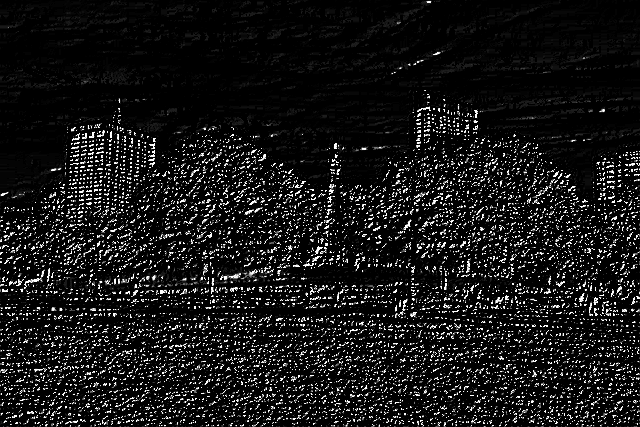

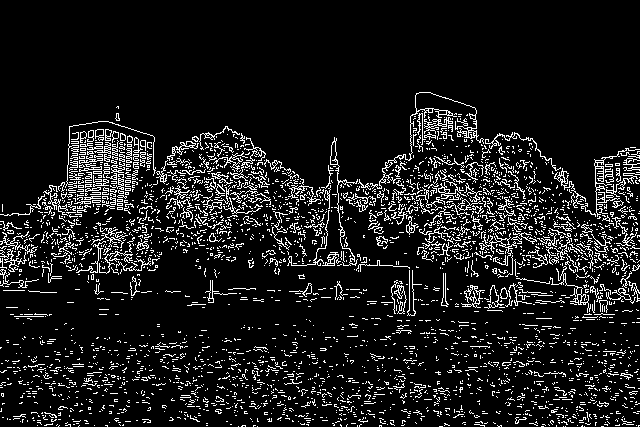

-1

In [20]:
#pylint:disable=no-member

import cv2 as cv
import numpy as np

img = cv.imread('/kaggle/input/resources/park.jpg')
cv2_imshow(img)

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)

# Laplacian
lap = cv.Laplacian(gray, cv.CV_64F)
lap = np.uint8(np.absolute(lap))
cv2_imshow(lap)

# Sobel
sobelx = cv.Sobel(gray, cv.CV_64F, 1, 0)
sobely = cv.Sobel(gray, cv.CV_64F, 0, 1)
combined_sobel = cv.bitwise_or(sobelx, sobely)

cv2_imshow(sobelx)
cv2_imshow(sobely)
cv2_imshow(combined_sobel)

canny = cv.Canny(gray, 150, 175)
cv2_imshow(canny)
cv.waitKey(0)

# Face Detection with haar casade

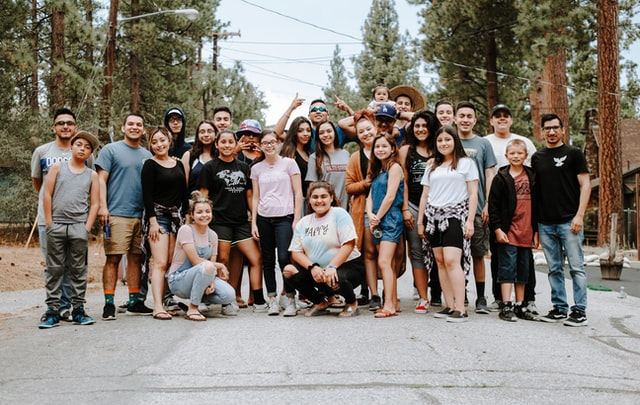

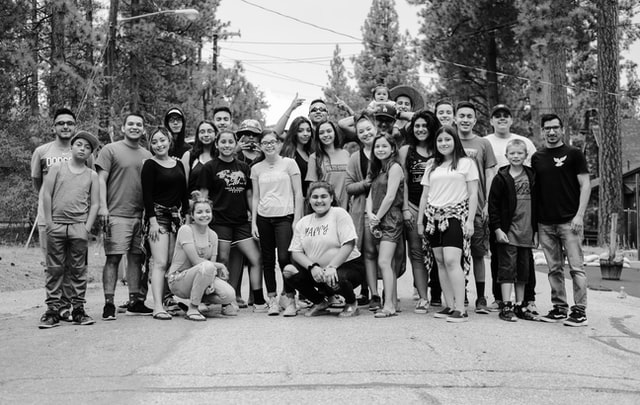

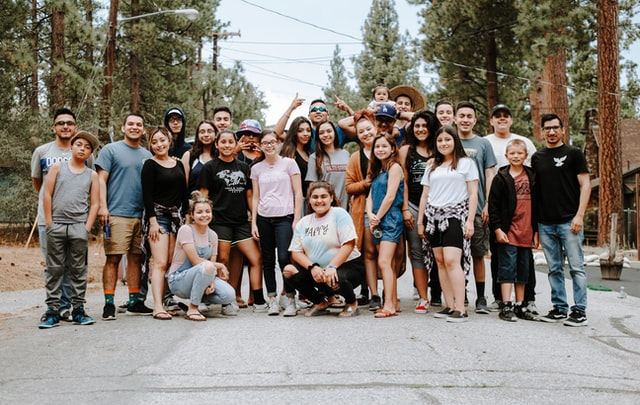

-1

In [21]:
#pylint:disable=no-member

import cv2 as cv

img = cv.imread('/kaggle/input/resources/group 1.jpg')
cv2_imshow(img)

gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
cv2_imshow(gray)




cv2_imshow(img)



cv.waitKey(0)